In [316]:
%reset

In [317]:
from Hydrograph.hydrograph import sepBaseflow, filterpeaks, maxFlowVolStats
# https://readthedocs.org/projects/hydrograph-py/downloads/pdf/latest/
#from Hydrograph.extreme_analysis import exceed, fitGEV, plotPDF, plotCDF, plotGEV

In [318]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
#import plotly.graph_objects as go

In [319]:
import os
#set path for root directory
ROOT_DIR = os.path.abspath(os.curdir)

In [320]:
%reload_ext autoreload
%autoreload 1
from hydroplotting import funcutils as fc

In [321]:
path_flow_obs = ROOT_DIR + '/Data/Raw/12147600_ref_short.csv'

<Axes: xlabel='datetime'>

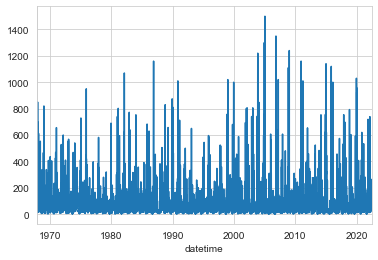

In [322]:
flow_obs = pd.read_csv(path_flow_obs,  header = None)
flow_obs.columns = ['year', 'month', 'day', 'Q_cms']
flow_obs['datetime'] = pd.to_datetime(flow_obs[['year', 'month', 'day']])
flow_obs = flow_obs.set_index('datetime')
flow_obs['datetime'] = pd.to_datetime(flow_obs[['year', 'month', 'day']])
fc.calc_water_year_apply(flow_obs)
flow_obs['water_year_str'] = flow_obs['water_year'].astype(str)
flow_obs.Q_cms.plot()

In [323]:
#exemplify for one water year: 2012
flow_obs_by_wy = flow_obs.groupby(['water_year_str'])
obs_2012 = flow_obs_by_wy.get_group('2012')
f = obs_2012.Q_cms
f = f.to_frame()
f = f.rename(columns = {"Q_cms":"Total runoff [m^3 s^-1]"})
f = f.rename(columns = {"datetime":"Date"})
#df.rename(columns={"OLD_COLUMN_VALUE": "NEW_COLUMN_VALUE"})
#df.rename(columns={"A": "a", "B": "c"})
f.index.names = ['Date']


In [324]:
test_flow = sepBaseflow(f, 1440, 49, k=0.000546, dt_max=None, tp_min=None)

Processing using a 60-minute interval...
2011-10-01 00:00:00
2011-10-01 01:00:00
2011-10-01 02:00:00
2011-10-01 03:00:00
2011-10-01 04:00:00
2011-10-01 05:00:00
2011-10-01 06:00:00
2011-10-01 07:00:00
2011-10-01 08:00:00
2011-10-01 09:00:00
2011-10-01 10:00:00
2011-10-01 11:00:00
2011-10-01 12:00:00
2011-10-01 13:00:00
2011-10-01 14:00:00
2011-10-01 15:00:00
2011-10-01 16:00:00
2011-10-01 17:00:00
2011-10-01 18:00:00
2011-10-01 19:00:00
2011-10-01 20:00:00
2011-10-01 21:00:00
2011-10-01 22:00:00
2011-10-01 23:00:00
2011-10-02 00:00:00
2011-10-02 01:00:00
2011-10-02 02:00:00
2011-10-02 03:00:00
2011-10-02 04:00:00
2011-10-02 05:00:00
2011-10-02 06:00:00
2011-10-02 07:00:00
2011-10-02 08:00:00
2011-10-02 09:00:00
2011-10-02 10:00:00
2011-10-02 11:00:00
2011-10-02 12:00:00
2011-10-02 13:00:00
2011-10-02 14:00:00
2011-10-02 15:00:00
2011-10-02 16:00:00
2011-10-02 17:00:00
2011-10-02 18:00:00
2011-10-02 19:00:00
2011-10-02 20:00:00
2011-10-02 21:00:00
2011-10-02 22:00:00
2011-10-02 23:00:00

<Axes: xlabel='Date'>

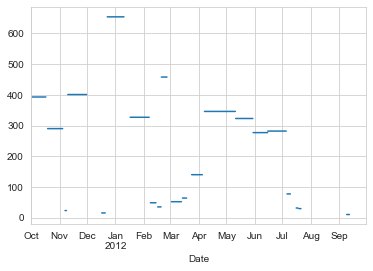

In [325]:
test_flow['Max. flow [m^3 s^-1]'].plot()

In [326]:
select_period = test_flow[test_flow.index.month.isin([10,11,1,2])]

peak_treshold = 200 #cms
filtered_values = select_period[(select_period['Max. flow [m^3 s^-1]'] > peak_treshold)]
#peaks
peaks = filtered_values .value_counts(filtered_values ['Max. flow [m^3 s^-1]'].values.ravel())
no_peaks = len(peaks)
#max_value = filtered_values .max(filtered_values ['Max. flow [m^3 s^-1]'].values.ravel())
max_peak = max(peaks)
max_peak

498

In [256]:
filtered_values

,dt [hour],Total runoff [m^3 s^-1],Total runoff interp. [m^3 s^-1],Baseflow [m^3 s^-1],Peakflow [m^3 s^-1],Peak nr.,Peakflow starts,Peakflow ends,Flow volume [m^3],Max. flow [m^3 s^-1],Date max. flow,Tp [hour]
Date,,,,,,,,,,,,
2011-10-02 01:00:00,1.0,NaN,11.341667,11.326754,0.014913,1.0,2011-10-02 01:00:00,2011-10-17 03:00:00,40830.0,393.0,2011-10-11,23.0
2011-10-02 02:00:00,1.0,NaN,11.383333,11.353508,0.029825,1.0,2011-10-02 01:00:00,2011-10-17 03:00:00,40980.0,393.0,2011-10-11,23.0
2011-10-02 03:00:00,1.0,NaN,11.425000,11.380262,0.044738,1.0,2011-10-02 01:00:00,2011-10-17 03:00:00,41130.0,393.0,2011-10-11,23.0
2011-10-02 04:00:00,1.0,NaN,11.466667,11.407016,0.059651,1.0,2011-10-02 01:00:00,2011-10-17 03:00:00,41280.0,393.0,2011-10-11,23.0
2011-10-02 05:00:00,1.0,NaN,11.508333,11.433770,0.074563,1.0,2011-10-02 01:00:00,2011-10-17 03:00:00,41430.0,393.0,2011-10-11,23.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2012-02-26 00:00:00,1.0,30.9,30.900000,29.052576,1.847424,10.0,2012-02-20 01:00:00,2012-02-26 04:00:00,111240.0,458.0,2012-02-22,23.0
2012-02-26 01:00:00,1.0,NaN,30.525000,29.079330,1.445670,10.0,2012-02-20 01:00:00,2012-02-26 04:00:00,109890.0,458.0,2012-02-22,23.0
2012-02-26 02:00:00,1.0,NaN,30.150000,29.106084,1.043916,10.0,2012-02-20 01:00:00,2012-02-26 04:00:00,108540.0,458.0,2012-02-22,23.0


In [302]:
#now loop through all the years

In [327]:
no_peaks = []
year = []
max_peak = []
peak_treshold = 200

for group in flow_obs_by_wy:
    f = group[1].Q_cms
    f = f.to_frame()
    f = f.rename(columns = {"Q_cms":"Total runoff [m^3 s^-1]"})
    f = f.rename(columns = {"datetime":"Date"})
    f.index.names = ['Date']
    flow_sep = sepBaseflow(f, 1440, 49, k=0.000546, dt_max=None, tp_min=None)
    select_period = flow_sep[flow_sep.index.month.isin([10,11,1,2])]
    filtered_values = select_period[(select_period['Max. flow [m^3 s^-1]'] > peak_treshold)]
    peaks = filtered_values .value_counts(filtered_values ['Max. flow [m^3 s^-1]'].values.ravel())
    no_peaks_ = len(peaks)
    #max_peak_ = max(peaks.iloc[:])
    max_peak_ = peaks.max()
    year.append(group[0])
    no_peaks.append(no_peaks_)
    max_peak.append(max_peak_)

peaks_year = dict(zip(year, no_peaks))
max_peak_year = dict(zip(year, max_peak))
peaks_year
max_peak_year



Processing using a 60-minute interval...
1967-11-01 00:00:00
1967-11-01 01:00:00
1967-11-01 02:00:00
1967-11-01 03:00:00
1967-11-01 04:00:00
1967-11-01 05:00:00
1967-11-01 06:00:00
1967-11-01 07:00:00
1967-11-01 08:00:00
1967-11-01 09:00:00
1967-11-01 10:00:00
1967-11-01 11:00:00
1967-11-01 12:00:00
1967-11-01 13:00:00
1967-11-01 14:00:00
1967-11-01 15:00:00
1967-11-01 16:00:00
1967-11-01 17:00:00
1967-11-01 18:00:00
1967-11-01 19:00:00
1967-11-01 20:00:00
1967-11-01 21:00:00
1967-11-01 22:00:00
1967-11-01 23:00:00
1967-11-02 00:00:00
1967-11-02 01:00:00
1967-11-02 02:00:00
1967-11-02 03:00:00
1967-11-02 04:00:00
1967-11-02 05:00:00
1967-11-02 06:00:00
1967-11-02 07:00:00
1967-11-02 08:00:00
1967-11-02 09:00:00
1967-11-02 10:00:00
1967-11-02 11:00:00
1967-11-02 12:00:00
1967-11-02 13:00:00
1967-11-02 14:00:00
1967-11-02 15:00:00
1967-11-02 16:00:00
1967-11-02 17:00:00
1967-11-02 18:00:00
1967-11-02 19:00:00
1967-11-02 20:00:00
1967-11-02 21:00:00
1967-11-02 22:00:00
1967-11-02 23:00:00

{'1968': 372,
 '1969': 335,
 '1970': 958,
 '1971': 738,
 '1972': 856,
 '1973': 475,
 '1974': 986,
 '1975': 595,
 '1976': 938,
 '1977': 349,
 '1978': 672,
 '1979': 409,
 '1980': 383,
 '1981': 767,
 '1982': 687,
 '1983': 472,
 '1984': 773,
 '1985': 935,
 '1986': 787,
 '1987': 911,
 '1988': 434,
 '1989': 475,
 '1990': 1032,
 '1991': 1173,
 '1992': 671,
 '1993': 632,
 '1994': 626,
 '1995': 387,
 '1996': 647,
 '1997': 956,
 '1998': 549,
 '1999': 523,
 '2000': 935,
 '2001': 202,
 '2002': 767,
 '2003': 492,
 '2004': 765,
 '2005': 869,
 '2006': 876,
 '2007': 1023,
 '2008': 143,
 '2009': 667,
 '2010': 857,
 '2011': 681,
 '2012': 498,
 '2013': 861,
 '2014': 566,
 '2015': 789,
 '2016': 1006,
 '2017': 906,
 '2018': 598,
 '2019': 435,
 '2020': 706,
 '2021': 749,
 '2022': 542}

In [328]:
df_peaks = pd.DataFrame(peaks_year.items())
df_peaks.columns.names=['index']
df_peaks.columns = ['year', 'no_peaks']
# saving the dataframe
#df_peaks.to_csv('/Users/nicoleta/Desktop/code/Snow_SCL/Data/Raw/peaks_300.csv')
df_peaks_max = pd.DataFrame(max_peak_year.items())
df_peaks_max.columns.names=['index']
df_peaks_max.columns = ['year', 'max_peak']

In [329]:
df_peaks['max_peak'] = df_peaks_max.max_peak.values
#vertical_concat = pd.concat([df1, df2], axis=0)
df_peaks.to_csv('/Users/nicoleta/Desktop/code/Snow_SCL/Data/Raw/peaks_200.csv')

In [315]:
df_peaks

,year,no_peaks,max_peak
0,1968,4,372.0
1,1969,3,335.0
2,1970,1,958.0
3,1971,3,738.0
4,1972,4,856.0
5,1973,2,362.0
6,1974,3,986.0
7,1975,1,474.0
8,1976,5,938.0
9,1977,1,349.0
